In [1]:
###Importing all Libraries###
import pandas as pd
import numpy as np
import seaborn as sns
import ppscore as pps
import sweetviz as sv
import pandas_profiling as pp
import matplotlib.pyplot as plt
import tensorflow as tf
import warnings
warnings.filterwarnings('ignore')

from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from sklearn.ensemble import IsolationForest
from sklearn.feature_selection import SelectKBest, RFE
from sklearn.feature_selection import chi2, f_classif, mutual_info_classif
from sklearn.linear_model import LogisticRegression
from sklearn.tree import  DecisionTreeClassifier
from mlxtend.feature_selection import SequentialFeatureSelector, ExhaustiveFeatureSelector
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
from sklearn.model_selection import cross_val_score, train_test_split, KFold
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.naive_bayes import BernoulliNB
from sklearn.svm import SVC
from collections import Counter
from sklearn.datasets import make_classification
from imblearn.over_sampling import RandomOverSampler

C:\Users\Asus\AppData\Local\Temp\ipykernel_7696\1437472088.py:7: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  import pandas_profiling as pp


In [2]:
#reading the dataset
df = pd.read_excel("Churn.xlsx", index_col=0)
df

,state,area.code,account.length,voice.plan,voice.messages,intl.plan,intl.mins,intl.calls,intl.charge,day.mins,day.calls,day.charge,eve.mins,eve.calls,eve.charge,night.mins,night.calls,night.charge,customer.calls,churn
1,KS,area_code_415,128,yes,25,no,10.0,3,2.70,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,1,no
2,OH,area_code_415,107,yes,26,no,13.7,3,3.70,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,1,no
3,NJ,area_code_415,137,no,0,no,12.2,5,3.29,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,0,no
4,OH,area_code_408,84,no,0,yes,6.6,7,1.78,299.4,71,50.9,61.9,88,5.26,196.9,89,8.86,2,no
5,OK,area_code_415,75,no,0,yes,10.1,3,2.73,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,3,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4996,HI,area_code_408,50,yes,40,no,9.9,5,2.67,235.7,127,40.07,223,126,18.96,297.5,116,13.39,2,no
4997,WV,area_code_415,152,no,0,no,14.7,2,3.97,184.2,90,31.31,256.8,73,21.83,213.6,113,9.61,3,yes
4998,DC,area_code_415,61,no,0,no,13.6,4,3.67,140.6,89,23.9,172.8,128,14.69,212.4,97,9.56,1,no
4999,DC,area_code_510,109,no,0,no,8.5,6,2.30,188.8,67,32.1,171.7,92,14.59,224.4,89,10.10,0,no


## <span style="color:darkred">EDA 

**<span style="color:darkblue">Data Cleaning**

In [3]:
#displays (rows,cloumns)
df.shape

(5000, 20)

In [4]:
#examining the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5000 entries, 1 to 5000
Data columns (total 20 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   state           5000 non-null   object 
 1   area.code       5000 non-null   object 
 2   account.length  5000 non-null   int64  
 3   voice.plan      5000 non-null   object 
 4   voice.messages  5000 non-null   int64  
 5   intl.plan       5000 non-null   object 
 6   intl.mins       5000 non-null   float64
 7   intl.calls      5000 non-null   int64  
 8   intl.charge     5000 non-null   float64
 9   day.mins        5000 non-null   float64
 10  day.calls       5000 non-null   int64  
 11  day.charge      5000 non-null   object 
 12  eve.mins        5000 non-null   object 
 13  eve.calls       5000 non-null   int64  
 14  eve.charge      5000 non-null   float64
 15  night.mins      5000 non-null   float64
 16  night.calls     5000 non-null   int64  
 17  night.charge    5000 non-null   f

In [5]:
#changing 'object' to 'float' datatype 
df["day.charge"] = df["day.charge"].astype(float)
df["eve.mins"] = df["eve.mins"].astype(float)

In [6]:
#examining the dataset (changed data type to float)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5000 entries, 1 to 5000
Data columns (total 20 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   state           5000 non-null   object 
 1   area.code       5000 non-null   object 
 2   account.length  5000 non-null   int64  
 3   voice.plan      5000 non-null   object 
 4   voice.messages  5000 non-null   int64  
 5   intl.plan       5000 non-null   object 
 6   intl.mins       5000 non-null   float64
 7   intl.calls      5000 non-null   int64  
 8   intl.charge     5000 non-null   float64
 9   day.mins        5000 non-null   float64
 10  day.calls       5000 non-null   int64  
 11  day.charge      4993 non-null   float64
 12  eve.mins        4976 non-null   float64
 13  eve.calls       5000 non-null   int64  
 14  eve.charge      5000 non-null   float64
 15  night.mins      5000 non-null   float64
 16  night.calls     5000 non-null   int64  
 17  night.charge    5000 non-null   f

In [7]:
#checking for null values
df.isnull().sum()

state              0
area.code          0
account.length     0
voice.plan         0
voice.messages     0
intl.plan          0
intl.mins          0
intl.calls         0
intl.charge        0
day.mins           0
day.calls          0
day.charge         7
eve.mins          24
eve.calls          0
eve.charge         0
night.mins         0
night.calls        0
night.charge       0
customer.calls     0
churn              0
dtype: int64

In [8]:
#dropping the null values
df.dropna(inplace=True)

In [9]:
#checking for duplicated rows (none found)
df[df.duplicated()]

,state,area.code,account.length,voice.plan,voice.messages,intl.plan,intl.mins,intl.calls,intl.charge,day.mins,day.calls,day.charge,eve.mins,eve.calls,eve.charge,night.mins,night.calls,night.charge,customer.calls,churn


In [10]:
#define all unique values
df.nunique()

state               51
area.code            3
account.length     218
voice.plan           2
voice.messages      48
intl.plan            2
intl.mins          170
intl.calls          21
intl.charge        170
day.mins          1957
day.calls          123
day.charge        1957
eve.mins          1875
eve.calls          126
eve.charge        1655
night.mins        1849
night.calls        131
night.charge      1028
customer.calls      10
churn                2
dtype: int64

In [11]:
#displaying the basic descriptive stats like mean, std deviation, median, min, max...
df.describe()

,account.length,voice.messages,intl.mins,intl.calls,intl.charge,day.mins,day.calls,day.charge,eve.mins,eve.calls,eve.charge,night.mins,night.calls,night.charge,customer.calls
count,4969.000000,4969.000000,4969.000000,4969.000000,4969.000000,4969.000000,4969.000000,4969.000000,4969.000000,4969.000000,4969.000000,4969.000000,4969.000000,4969.000000,4969.000000
mean,100.206681,7.754880,10.264198,4.433085,2.771851,180.306178,100.021936,30.652604,200.617368,100.174884,17.052695,200.434675,99.954518,9.019670,1.571946
std,39.695476,13.545738,2.761996,2.459495,0.745672,53.931206,19.835965,9.168275,50.550590,19.833572,4.296784,50.528158,19.959015,2.273776,1.307458
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,73.000000,0.000000,8.500000,3.000000,2.300000,143.700000,87.000000,24.430000,166.400000,87.000000,14.140000,167.100000,87.000000,7.520000,1.000000
50%,100.000000,0.000000,10.300000,4.000000,2.780000,180.100000,100.000000,30.620000,201.000000,100.000000,17.090000,200.400000,100.000000,9.020000,1.000000
75%,127.000000,17.000000,12.000000,6.000000,3.240000,216.200000,113.000000,36.750000,234.100000,113.000000,19.900000,234.700000,113.000000,10.560000,2.000000
max,243.000000,52.000000,20.000000,20.000000,5.400000,351.500000,165.000000,59.760000,363.700000,170.000000,30.910000,395.000000,175.000000,17.770000,9.000000


In [12]:
#checking details about the dataset
#we see that we have 5000 entries and no null value is present 
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4969 entries, 1 to 5000
Data columns (total 20 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   state           4969 non-null   object 
 1   area.code       4969 non-null   object 
 2   account.length  4969 non-null   int64  
 3   voice.plan      4969 non-null   object 
 4   voice.messages  4969 non-null   int64  
 5   intl.plan       4969 non-null   object 
 6   intl.mins       4969 non-null   float64
 7   intl.calls      4969 non-null   int64  
 8   intl.charge     4969 non-null   float64
 9   day.mins        4969 non-null   float64
 10  day.calls       4969 non-null   int64  
 11  day.charge      4969 non-null   float64
 12  eve.mins        4969 non-null   float64
 13  eve.calls       4969 non-null   int64  
 14  eve.charge      4969 non-null   float64
 15  night.mins      4969 non-null   float64
 16  night.calls     4969 non-null   int64  
 17  night.charge    4969 non-null   f

In [13]:
#count the churn value yes or no
df.churn.value_counts()

no     4264
yes     705
Name: churn, dtype: int64

Text(0.5, 1.0, 'Pie chart of Churn')

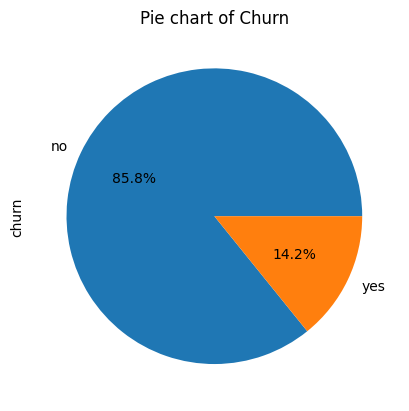

In [14]:
#pie chart for churn model where shows percentage of churn
df['churn'].value_counts().plot.pie(autopct = '%1.1f%%')
plt.title("Pie chart of Churn")

<Axes: xlabel='churn', ylabel='count'>

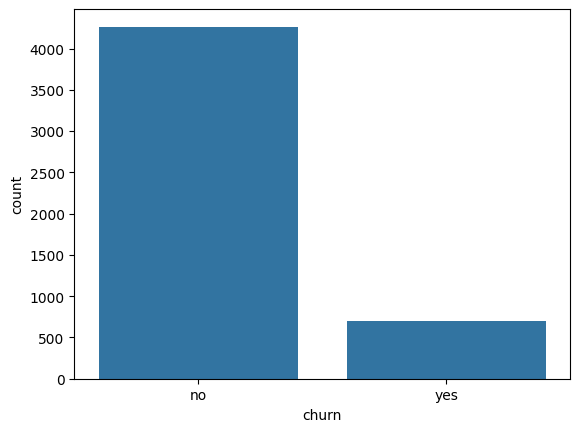

In [15]:
# countplot of churn
sns.countplot(x =  df.churn)

Observation :-
 After analyzing the we had say that almost 15% that counts to only 707 out of 5000 customer have churned.

In [16]:
#examining the correlation values
df.corr()

,account.length,voice.messages,intl.mins,intl.calls,intl.charge,day.mins,day.calls,day.charge,eve.mins,eve.calls,eve.charge,night.mins,night.calls,night.charge,customer.calls
account.length,1.000000,-0.013682,0.004165,0.014686,0.004173,-0.000715,0.027558,-0.000717,-0.007600,0.008187,-0.007597,0.001229,-0.008077,0.001218,-0.002457
voice.messages,-0.013682,1.000000,0.001497,-0.000970,0.001539,0.005641,0.001008,0.005636,0.018517,-0.003682,0.018523,0.004094,0.001903,0.004086,-0.006676
intl.mins,0.004165,0.001497,1.000000,0.016604,0.999993,-0.018335,0.014284,-0.018339,-0.000533,-0.006097,-0.000539,-0.006178,0.000429,-0.006174,-0.010839
intl.calls,0.014686,-0.000970,0.016604,1.000000,0.016714,-0.000541,0.011457,-0.000544,0.007402,0.006675,0.007407,-0.017202,0.000008,-0.017172,-0.019519
intl.charge,0.004173,0.001539,0.999993,0.016714,1.000000,-0.018261,0.014348,-0.018265,-0.000512,-0.006151,-0.000518,-0.006119,0.000411,-0.006114,-0.010893
day.mins,-0.000715,0.005641,-0.018335,-0.000541,-0.018261,1.000000,-0.000342,1.000000,-0.011572,0.006587,-0.011581,0.011755,0.004091,0.011738,0.002573
day.calls,0.027558,0.001008,0.014284,0.011457,0.014348,-0.000342,1.000000,-0.000342,-0.001526,0.001984,-0.001522,0.002023,-0.008645,0.002019,-0.010938
day.charge,-0.000717,0.005636,-0.018339,-0.000544,-0.018265,1.000000,-0.000342,1.000000,-0.011568,0.006588,-0.011578,0.011757,0.004090,0.011740,0.002567
eve.mins,-0.007600,0.018517,-0.000533,0.007402,-0.000512,-0.011572,-0.001526,-0.011568,1.000000,0.002429,1.000000,-0.017189,0.016336,-0.017191,-0.011936
eve.calls,0.008187,-0.003682,-0.006097,0.006675,-0.006151,0.006587,0.001984,0.006588,0.002429,1.000000,0.002444,0.002049,-0.012014,0.002068,0.005985


<Axes: >

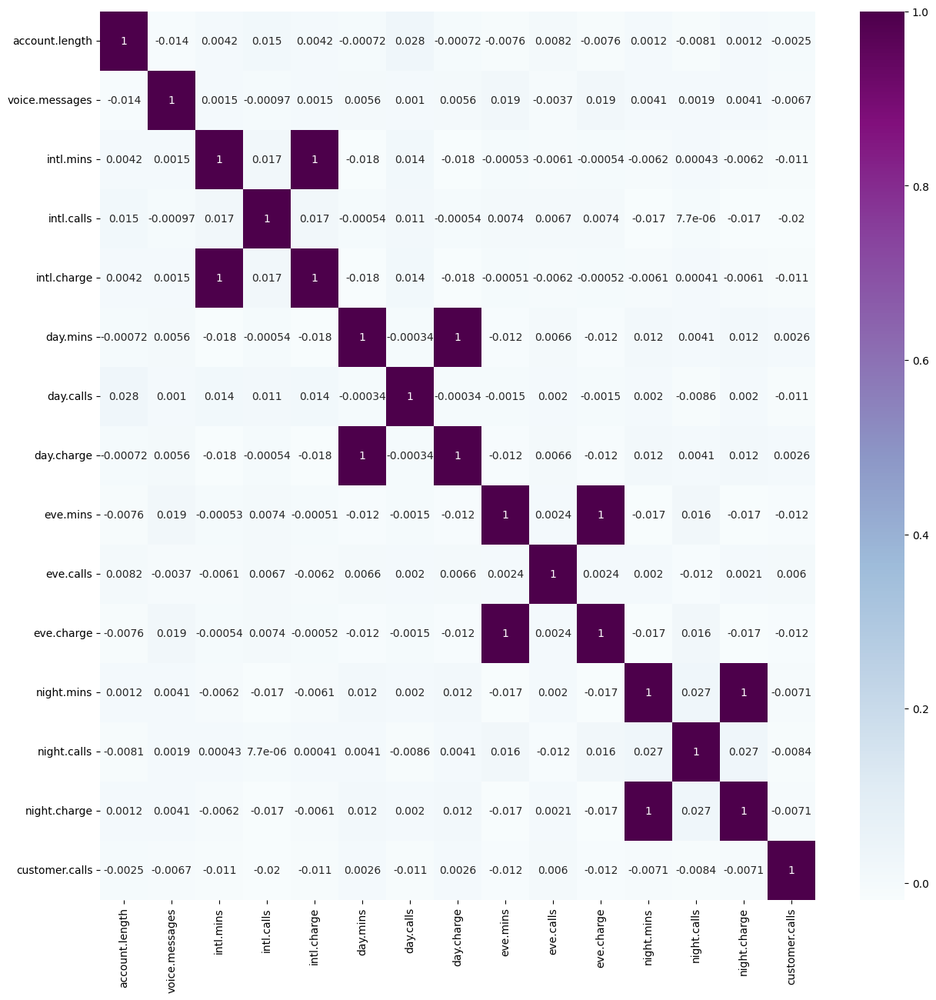

In [17]:
#examining the correlation values through a heatmap
plt.figure(figsize=(15,15))
sns.heatmap(df.corr(), annot=True, cmap="BuPu")

From the above heatmap observation the data says that intl.charge & intl.mins, day.charge & day.mins, eve.charge &eve.mins, night.charge & night.mins are positively highly correlated with a 1

In [18]:
# to view all data of dataset
pd.set_option("display.max_rows",None )

In [19]:
fs = pps.matrix(df)
fs

,x,y,ppscore,case,is_valid_score,metric,baseline_score,model_score,model
0,state,state,1.000000e+00,predict_itself,True,None,0.000000,1.000000,None
1,state,area.code,0.000000e+00,classification,True,weighted F1,0.378949,0.343130,DecisionTreeClassifier()
2,state,account.length,0.000000e+00,regression,True,mean absolute error,31.732944,32.023443,DecisionTreeRegressor()
3,state,voice.plan,1.398849e-07,classification,True,weighted F1,0.623218,0.623218,DecisionTreeClassifier()
4,state,voice.messages,0.000000e+00,regression,True,mean absolute error,7.754880,11.456482,DecisionTreeRegressor()
5,state,intl.plan,1.027799e-06,classification,True,weighted F1,0.860468,0.860468,DecisionTreeClassifier()
6,state,intl.mins,0.000000e+00,regression,True,mean absolute error,2.156510,2.170279,DecisionTreeRegressor()
7,state,intl.calls,0.000000e+00,regression,True,mean absolute error,1.784262,1.871594,DecisionTreeRegressor()
8,state,intl.charge,0.000000e+00,regression,True,mean absolute error,0.582284,0.585912,DecisionTreeRegressor()
9,state,day.mins,0.000000e+00,regression,True,mean absolute error,43.022117,43.421859,DecisionTreeRegressor()


In [20]:

fs[fs['y'] == 'churn']

,x,y,ppscore,case,is_valid_score,metric,baseline_score,model_score,model
19,state,churn,8.483278e-07,classification,True,weighted F1,0.792597,0.792597,DecisionTreeClassifier()
39,area.code,churn,8.483278e-07,classification,True,weighted F1,0.792597,0.792597,DecisionTreeClassifier()
59,account.length,churn,0.000000e+00,classification,True,weighted F1,0.792597,0.792077,DecisionTreeClassifier()
79,voice.plan,churn,8.483278e-07,classification,True,weighted F1,0.792597,0.792597,DecisionTreeClassifier()
99,voice.messages,churn,0.000000e+00,classification,True,weighted F1,0.792597,0.792397,DecisionTreeClassifier()
119,intl.plan,churn,8.483278e-07,classification,True,weighted F1,0.792597,0.792597,DecisionTreeClassifier()
139,intl.mins,churn,3.975044e-03,classification,True,weighted F1,0.792597,0.793422,DecisionTreeClassifier()
159,intl.calls,churn,8.483278e-07,classification,True,weighted F1,0.792597,0.792597,DecisionTreeClassifier()
179,intl.charge,churn,3.975044e-03,classification,True,weighted F1,0.792597,0.793422,DecisionTreeClassifier()
199,day.mins,churn,1.076859e-01,classification,True,weighted F1,0.792597,0.814932,DecisionTreeClassifier()


In [21]:
#predictive power score of case: classification
fs[fs['case'] == 'classification'].sort_values(by = 'ppscore', ascending = False)

,x,y,ppscore,case,is_valid_score,metric,baseline_score,model_score,model
83,voice.messages,voice.plan,9.994655e-01,classification,True,weighted F1,0.623218,0.999799,DecisionTreeClassifier()
379,customer.calls,churn,1.421376e-01,classification,True,weighted F1,0.792597,0.822077,DecisionTreeClassifier()
239,day.charge,churn,1.135527e-01,classification,True,weighted F1,0.792597,0.816148,DecisionTreeClassifier()
199,day.mins,churn,1.076859e-01,classification,True,weighted F1,0.792597,0.814932,DecisionTreeClassifier()
243,eve.mins,voice.plan,5.898430e-02,classification,True,weighted F1,0.623218,0.645442,DecisionTreeClassifier()
223,day.charge,voice.plan,4.823176e-02,classification,True,weighted F1,0.623218,0.641390,DecisionTreeClassifier()
283,eve.charge,voice.plan,4.756116e-02,classification,True,weighted F1,0.623218,0.641138,DecisionTreeClassifier()
183,day.mins,voice.plan,3.818737e-02,classification,True,weighted F1,0.623218,0.637606,DecisionTreeClassifier()
343,night.charge,voice.plan,3.446301e-02,classification,True,weighted F1,0.623218,0.636203,DecisionTreeClassifier()
43,account.length,voice.plan,3.188553e-02,classification,True,weighted F1,0.623218,0.635231,DecisionTreeClassifier()


*<span style="color:orange">voice.messages and voice.plan have high pps.*

In [22]:
fs[fs['case'] == 'regression'].sort_values(by = 'ppscore', ascending = False)

,x,y,ppscore,case,is_valid_score,metric,baseline_score,model_score,model
166,intl.charge,intl.mins,0.999711,regression,True,mean absolute error,2.156510,0.000624,DecisionTreeRegressor()
128,intl.mins,intl.charge,0.999710,regression,True,mean absolute error,0.582284,0.000169,DecisionTreeRegressor()
191,day.mins,day.charge,0.999129,regression,True,mean absolute error,7.313695,0.006370,DecisionTreeRegressor()
229,day.charge,day.mins,0.999125,regression,True,mean absolute error,43.022117,0.037655,DecisionTreeRegressor()
254,eve.mins,eve.charge,0.998939,regression,True,mean absolute error,3.422658,0.003632,DecisionTreeRegressor()
317,night.mins,night.charge,0.998828,regression,True,mean absolute error,1.812079,0.002123,DecisionTreeRegressor()
292,eve.charge,eve.mins,0.998640,regression,True,mean absolute error,40.266351,0.054764,DecisionTreeRegressor()
355,night.charge,night.mins,0.997742,regression,True,mean absolute error,40.267639,0.090937,DecisionTreeRegressor()
64,voice.plan,voice.messages,0.784774,regression,True,mean absolute error,7.754880,1.669054,DecisionTreeRegressor()
148,intl.calls,intl.charge,0.018792,regression,True,mean absolute error,0.582284,0.571342,DecisionTreeRegressor()


*<span style="color:orange">Minutes and Charge have high pps*

 **<span style="color:darkblue">DATA TRANSFORMATION**

In [23]:
#label encoding
le = LabelEncoder()

df['state'] = le.fit_transform(df['state'])
df['area.code'] = le.fit_transform(df['area.code'])
df['voice.plan'] = le.fit_transform(df['voice.plan'])
df['intl.plan'] = le.fit_transform(df['intl.plan'])
df['churn'] = le.fit_transform(df['churn'])

df

,state,area.code,account.length,voice.plan,voice.messages,intl.plan,intl.mins,intl.calls,intl.charge,day.mins,day.calls,day.charge,eve.mins,eve.calls,eve.charge,night.mins,night.calls,night.charge,customer.calls,churn
1,16,1,128,1,25,0,10.0,3,2.70,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,1,0
2,35,1,107,1,26,0,13.7,3,3.70,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,1,0
3,31,1,137,0,0,0,12.2,5,3.29,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,0,0
4,35,0,84,0,0,1,6.6,7,1.78,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,2,0
5,36,1,75,0,0,1,10.1,3,2.73,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,3,0
6,1,2,118,0,0,1,6.3,6,1.70,223.4,98,37.98,220.6,101,18.75,203.9,118,9.18,0,0
7,19,2,121,1,24,0,7.5,7,2.03,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,3,0
8,24,1,147,0,0,1,7.1,6,1.92,157.0,79,26.69,103.1,94,8.76,211.8,96,9.53,0,0
9,18,0,117,0,0,0,8.7,4,2.35,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,1,0
10,49,1,141,1,37,1,11.2,5,3.02,258.6,84,43.96,222.0,111,18.87,326.4,97,14.69,0,0


In [24]:
#normalization of dataset
sc = MinMaxScaler()

df.iloc[:,[2,4,6,7,8,9,10,11,12,13,14,15,16,17,18]] = sc.fit_transform(df.iloc[:,[2,4,6,7,8,9,10,11,12,13,14,15,16,17,18]])
df

,state,area.code,account.length,voice.plan,voice.messages,intl.plan,intl.mins,intl.calls,intl.charge,day.mins,day.calls,day.charge,eve.mins,eve.calls,eve.charge,night.mins,night.calls,night.charge,customer.calls,churn
1,16,1,0.524793,1,0.480769,0,0.500,0.15,0.500000,0.754196,0.666667,0.754183,0.542755,0.582353,0.542866,0.619494,0.520000,0.619584,0.111111,0
2,35,1,0.438017,1,0.500000,0,0.685,0.15,0.685185,0.459744,0.745455,0.459672,0.537531,0.605882,0.537690,0.644051,0.588571,0.644344,0.111111,0
3,31,1,0.561983,0,0.000000,0,0.610,0.25,0.609259,0.692461,0.690909,0.692436,0.333242,0.647059,0.333225,0.411646,0.594286,0.411930,0.000000,0
4,35,0,0.342975,0,0.000000,1,0.330,0.35,0.329630,0.851778,0.430303,0.851740,0.170195,0.517647,0.170171,0.498481,0.508571,0.498593,0.222222,0
5,36,1,0.305785,0,0.000000,1,0.505,0.15,0.505556,0.474253,0.684848,0.474230,0.407754,0.717647,0.407959,0.473165,0.691429,0.473270,0.333333,0
6,1,2,0.483471,0,0.000000,1,0.315,0.30,0.314815,0.635562,0.593939,0.635542,0.606544,0.594118,0.606600,0.516203,0.674286,0.516601,0.000000,0
7,19,2,0.495868,1,0.461538,0,0.375,0.35,0.375926,0.620768,0.533333,0.620649,0.958207,0.635294,0.958266,0.538228,0.674286,0.538548,0.333333,0
8,24,1,0.603306,0,0.000000,1,0.355,0.30,0.355556,0.446657,0.478788,0.446620,0.283475,0.552941,0.283403,0.536203,0.548571,0.536297,0.000000,0
9,18,0,0.479339,0,0.000000,0,0.435,0.20,0.435185,0.524893,0.587879,0.524933,0.966731,0.470588,0.967001,0.546329,0.514286,0.546427,0.111111,0
10,49,1,0.578512,1,0.711538,1,0.560,0.25,0.559259,0.735704,0.509091,0.735609,0.610393,0.652941,0.610482,0.826329,0.554286,0.826674,0.000000,0


**<span style="color:darkblue">OUTLIER DETECTION**


There are multiple approaches to detect outliers in the dataset.
1. Histogram
2. Boxplot
3. Descriptive stats for df

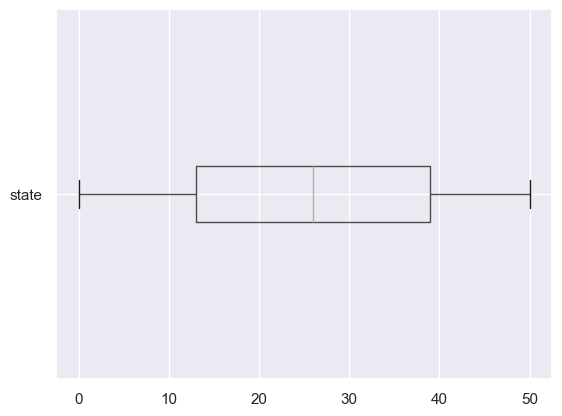

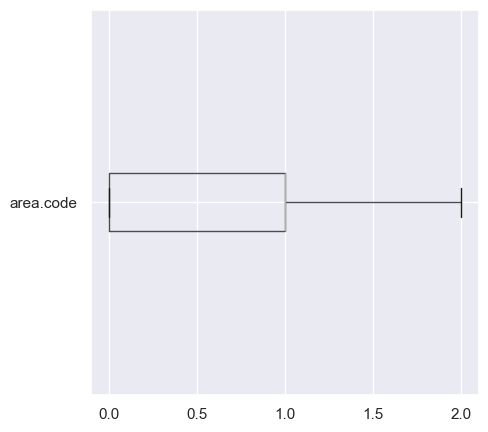

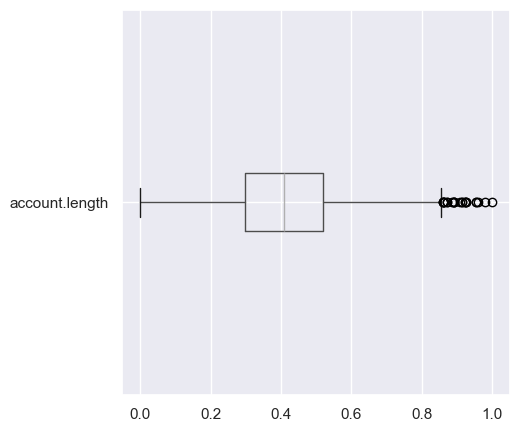

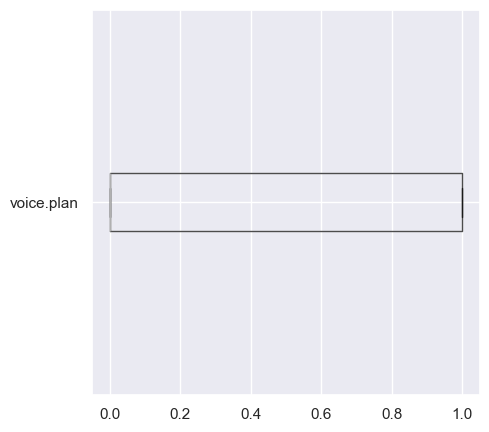

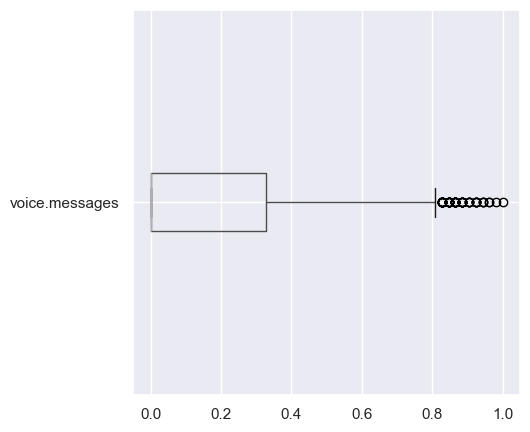

...

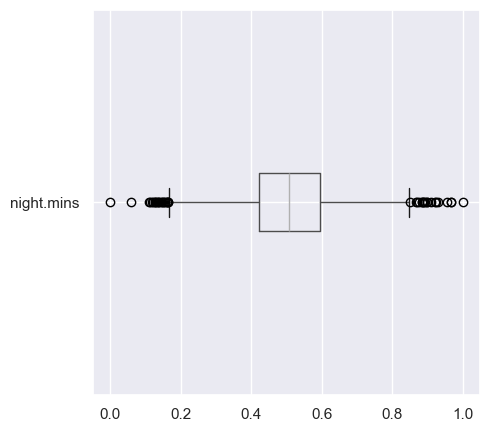

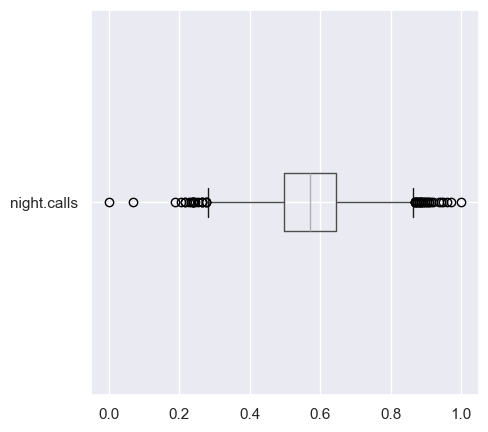

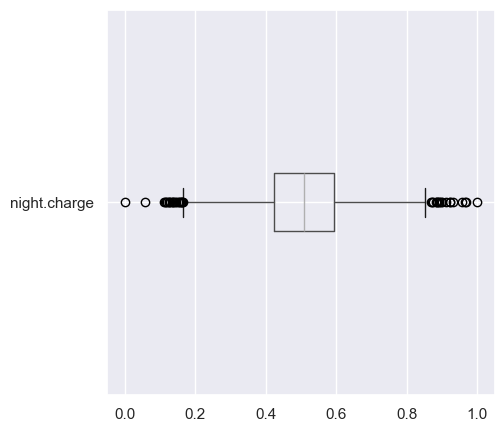

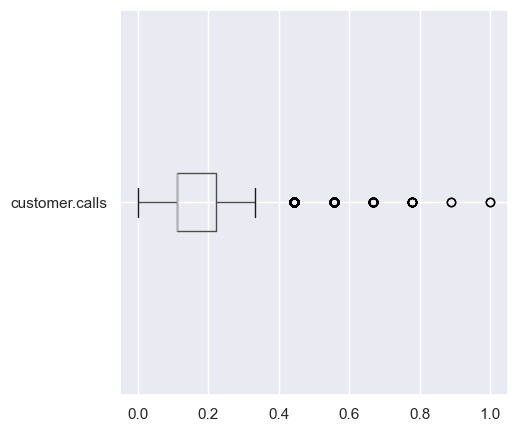

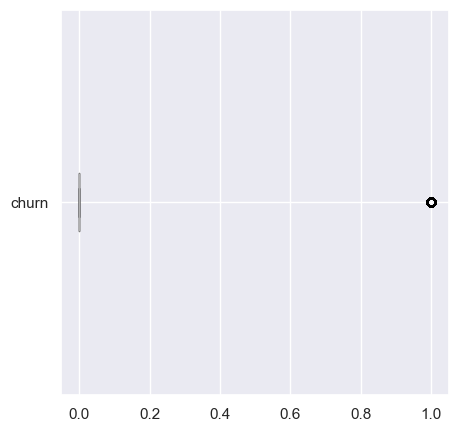

In [25]:
#boxplots for each column
for column in df:
    plt.figure()
    sns.set(rc = {'figure.figsize':(5,5)})
    df.boxplot([column],vert = False)

In [26]:
iso = IsolationForest()

iso.fit(df)

IsolationForest()

In [27]:
# Fitting the Isolation Forest model
iso = IsolationForest()
iso.fit(df)

# Predicting outliers
outlier = iso.predict(df)
outlier

array([1, 1, 1, ..., 1, 1, 1])

In [28]:
# Verify if 'outlier' column exists (optional, for clarity)
if 'outlier' not in df.columns:
    print("Column 'outlier' not found in the DataFrame. Adding it now.")
    df['outlier'] = outlier

# Filter the DataFrame based on the correct column name
try:
    df_filtered = df[df['outlier'] == 1]  # Assuming 1 indicates outliers (adjust if different)
except KeyError:
    print("Column 'outlier' might not exist. Check your code for adding outlier predictions.")

# Proceed with your clustering analysis using df_filtered (if successful)

Column 'outlier' not found in the DataFrame. Adding it now.


In [29]:
df['outlier'].value_counts()

 1    4266
-1     703
Name: outlier, dtype: int64

In [30]:
df[df['outlier'] == 1]

,state,area.code,account.length,voice.plan,voice.messages,intl.plan,intl.mins,intl.calls,intl.charge,day.mins,...,day.charge,eve.mins,eve.calls,eve.charge,night.mins,night.calls,night.charge,customer.calls,churn,outlier
1,16,1,0.524793,1,0.480769,0,0.500,0.15,0.500000,0.754196,...,0.754183,0.542755,0.582353,0.542866,0.619494,0.520000,0.619584,0.111111,0,1
2,35,1,0.438017,1,0.500000,0,0.685,0.15,0.685185,0.459744,...,0.459672,0.537531,0.605882,0.537690,0.644051,0.588571,0.644344,0.111111,0,1
3,31,1,0.561983,0,0.000000,0,0.610,0.25,0.609259,0.692461,...,0.692436,0.333242,0.647059,0.333225,0.411646,0.594286,0.411930,0.000000,0,1
5,36,1,0.305785,0,0.000000,1,0.505,0.15,0.505556,0.474253,...,0.474230,0.407754,0.717647,0.407959,0.473165,0.691429,0.473270,0.333333,0,1
6,1,2,0.483471,0,0.000000,1,0.315,0.30,0.314815,0.635562,...,0.635542,0.606544,0.594118,0.606600,0.516203,0.674286,0.516601,0.000000,0,1
7,19,2,0.495868,1,0.461538,0,0.375,0.35,0.375926,0.620768,...,0.620649,0.958207,0.635294,0.958266,0.538228,0.674286,0.538548,0.333333,0,1
8,24,1,0.603306,0,0.000000,1,0.355,0.30,0.355556,0.446657,...,0.446620,0.283475,0.552941,0.283403,0.536203,0.548571,0.536297,0.000000,0,1
9,18,0,0.479339,0,0.000000,0,0.435,0.20,0.435185,0.524893,...,0.524933,0.966731,0.470588,0.967001,0.546329,0.514286,0.546427,0.111111,0,1
11,15,1,0.264463,0,0.000000,0,0.635,0.30,0.635185,0.367283,...,0.367303,0.628265,0.488235,0.628276,0.528608,0.634286,0.528981,0.444444,1,1
12,39,1,0.301653,0,0.000000,0,0.455,0.25,0.455556,0.533997,...,0.533969,0.449271,0.870588,0.449369,0.496203,0.537143,0.496342,0.000000,0,1


In [31]:
df[df['outlier'] == -1]

,state,area.code,account.length,voice.plan,voice.messages,intl.plan,intl.mins,intl.calls,intl.charge,day.mins,...,day.charge,eve.mins,eve.calls,eve.charge,night.mins,night.calls,night.charge,customer.calls,churn,outlier
4,35,0,0.342975,0,0.000000,1,0.330,0.35,0.329630,0.851778,...,0.851740,0.170195,0.517647,0.170171,0.498481,0.508571,0.498593,0.222222,0,-1
10,49,1,0.578512,1,0.711538,1,0.560,0.25,0.559259,0.735704,...,0.735609,0.610393,0.652941,0.610482,0.826329,0.554286,0.826674,0.000000,0,-1
16,34,1,0.661157,0,0.000000,0,0.270,0.45,0.270370,0.947084,...,0.946954,0.873797,0.570588,0.873827,0.406582,0.731429,0.406866,0.444444,1,-1
17,13,0,0.347107,1,0.519231,0,0.690,0.20,0.690741,0.558748,...,0.558735,0.772340,0.529412,0.772566,0.226076,0.428571,0.226224,0.111111,0,-1
22,5,0,0.314050,0,0.000000,0,0.285,0.30,0.285185,0.177525,...,0.177544,0.467143,0.711765,0.467163,0.530633,0.365714,0.530670,0.555556,1,-1
34,3,0,0.045455,0,0.000000,0,0.590,0.15,0.590741,0.710100,...,0.710007,0.693979,0.700000,0.693950,0.709367,0.514286,0.709623,0.111111,1,-1
37,0,0,0.144628,1,0.576923,0,0.725,0.30,0.725926,0.416216,...,0.416165,0.446797,0.470588,0.446781,0.327342,0.622857,0.327518,0.000000,0,-1
39,0,1,0.557851,1,0.634615,1,0.525,0.30,0.525926,0.580085,...,0.579987,0.515810,0.582353,0.516014,0.257468,0.611429,0.257738,0.333333,0,-1
42,20,0,0.553719,1,0.788462,1,0.730,0.75,0.729630,0.492461,...,0.492470,0.560627,0.629412,0.560660,0.309367,0.445714,0.309510,0.000000,1,-1
58,5,0,0.495868,1,0.576923,0,0.290,0.15,0.290741,0.564438,...,0.564424,0.207039,0.452941,0.207053,0.458734,0.440000,0.458638,0.333333,1,-1


In [32]:
#dropping these columns since they will not be needed anymore
df.drop(columns=['outlier','outlier'],inplace=True)

In [33]:
df

,state,area.code,account.length,voice.plan,voice.messages,intl.plan,intl.mins,intl.calls,intl.charge,day.mins,day.calls,day.charge,eve.mins,eve.calls,eve.charge,night.mins,night.calls,night.charge,customer.calls,churn
1,16,1,0.524793,1,0.480769,0,0.500,0.15,0.500000,0.754196,0.666667,0.754183,0.542755,0.582353,0.542866,0.619494,0.520000,0.619584,0.111111,0
2,35,1,0.438017,1,0.500000,0,0.685,0.15,0.685185,0.459744,0.745455,0.459672,0.537531,0.605882,0.537690,0.644051,0.588571,0.644344,0.111111,0
3,31,1,0.561983,0,0.000000,0,0.610,0.25,0.609259,0.692461,0.690909,0.692436,0.333242,0.647059,0.333225,0.411646,0.594286,0.411930,0.000000,0
4,35,0,0.342975,0,0.000000,1,0.330,0.35,0.329630,0.851778,0.430303,0.851740,0.170195,0.517647,0.170171,0.498481,0.508571,0.498593,0.222222,0
5,36,1,0.305785,0,0.000000,1,0.505,0.15,0.505556,0.474253,0.684848,0.474230,0.407754,0.717647,0.407959,0.473165,0.691429,0.473270,0.333333,0
6,1,2,0.483471,0,0.000000,1,0.315,0.30,0.314815,0.635562,0.593939,0.635542,0.606544,0.594118,0.606600,0.516203,0.674286,0.516601,0.000000,0
7,19,2,0.495868,1,0.461538,0,0.375,0.35,0.375926,0.620768,0.533333,0.620649,0.958207,0.635294,0.958266,0.538228,0.674286,0.538548,0.333333,0
8,24,1,0.603306,0,0.000000,1,0.355,0.30,0.355556,0.446657,0.478788,0.446620,0.283475,0.552941,0.283403,0.536203,0.548571,0.536297,0.000000,0
9,18,0,0.479339,0,0.000000,0,0.435,0.20,0.435185,0.524893,0.587879,0.524933,0.966731,0.470588,0.967001,0.546329,0.514286,0.546427,0.111111,0
10,49,1,0.578512,1,0.711538,1,0.560,0.25,0.559259,0.735704,0.509091,0.735609,0.610393,0.652941,0.610482,0.826329,0.554286,0.826674,0.000000,0


In [34]:
#removing the outliers using IQR
#Outlier detection function

def outlier_detection(data,colname):
    q1 = data[colname].quantile(0.25)
    q3 = data[colname].quantile(0.75)
    iqr = q3 - q1
    
    upper = q3+(1.5*iqr)
    lower = q1+(1.5*iqr)
    
    return upper,lower
    

In [35]:

#Calculate the first and third quartiles (Q1 and Q3)
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)

# Calculate the IQR for each column
IQR = Q3 - Q1

# Remove outliers using the custom IQR multiplier for each column
upper = df[~(df > (Q3 + 1.5 * IQR)).any(axis=1)]
lower = df[~(df < (Q1 - 1.5 * IQR)).any(axis=1)] 


# Display the DataFrame after removing outliers

ds = pd.DataFrame(lower)
dss = pd.DataFrame(upper)
ds
dss

,state,area.code,account.length,voice.plan,voice.messages,intl.plan,intl.mins,intl.calls,intl.charge,day.mins,day.calls,day.charge,eve.mins,eve.calls,eve.charge,night.mins,night.calls,night.charge,customer.calls,churn
1,16,1,0.524793,1,0.480769,0,0.500,0.15,0.500000,0.754196,0.666667,0.754183,0.542755,0.582353,0.542866,0.619494,0.520000,0.619584,0.111111,0
2,35,1,0.438017,1,0.500000,0,0.685,0.15,0.685185,0.459744,0.745455,0.459672,0.537531,0.605882,0.537690,0.644051,0.588571,0.644344,0.111111,0
3,31,1,0.561983,0,0.000000,0,0.610,0.25,0.609259,0.692461,0.690909,0.692436,0.333242,0.647059,0.333225,0.411646,0.594286,0.411930,0.000000,0
12,39,1,0.301653,0,0.000000,0,0.455,0.25,0.455556,0.533997,0.769697,0.533969,0.449271,0.870588,0.449369,0.496203,0.537143,0.496342,0.000000,0
14,26,2,0.388430,0,0.000000,0,0.615,0.25,0.614815,0.445519,0.533333,0.445448,0.680781,0.441176,0.681009,0.486835,0.657143,0.486775,0.333333,0
17,13,0,0.347107,1,0.519231,0,0.690,0.20,0.690741,0.558748,0.842424,0.558735,0.772340,0.529412,0.772566,0.226076,0.428571,0.226224,0.111111,0
18,46,2,0.380165,0,0.000000,0,0.405,0.15,0.405556,0.542532,0.690909,0.542503,0.599945,0.652941,0.600129,0.328101,0.691429,0.328081,0.333333,0
19,45,2,0.309917,1,0.634615,0,0.500,0.25,0.500000,0.539687,0.400000,0.539659,0.585098,0.382353,0.585247,0.419494,0.617143,0.419809,0.111111,0
20,43,1,0.297521,0,0.000000,0,0.650,0.10,0.650000,0.638407,0.545455,0.638387,0.438548,0.517647,0.438693,0.488101,0.422857,0.488464,0.111111,0
21,9,1,0.603306,0,0.000000,0,0.530,0.20,0.529630,0.441252,0.709091,0.441265,0.659060,0.547059,0.659010,0.528608,0.760000,0.528981,0.000000,0


In [36]:
#EDA report

#EDA_report = pp.ProfileReport(df, vars = dict(num= {"low_categorical_threshold" : 0}))
#EDA_report

In [37]:
#report = sv.analyze(df)

In [38]:
#report

In [39]:
#report.show_html("sweetviz.html")

# **<span style="color:darkred">DATA VISUALIZATION**

In [40]:
df["area.code"].unique()

array([1, 0, 2])

In [41]:
# Grouping the churn with area code

area_churn = df.groupby(['area.code'])['churn'].value_counts().unstack()
area_churn

churn,0,1
area.code,,
0,1072,177
1,2135,344
2,1057,184


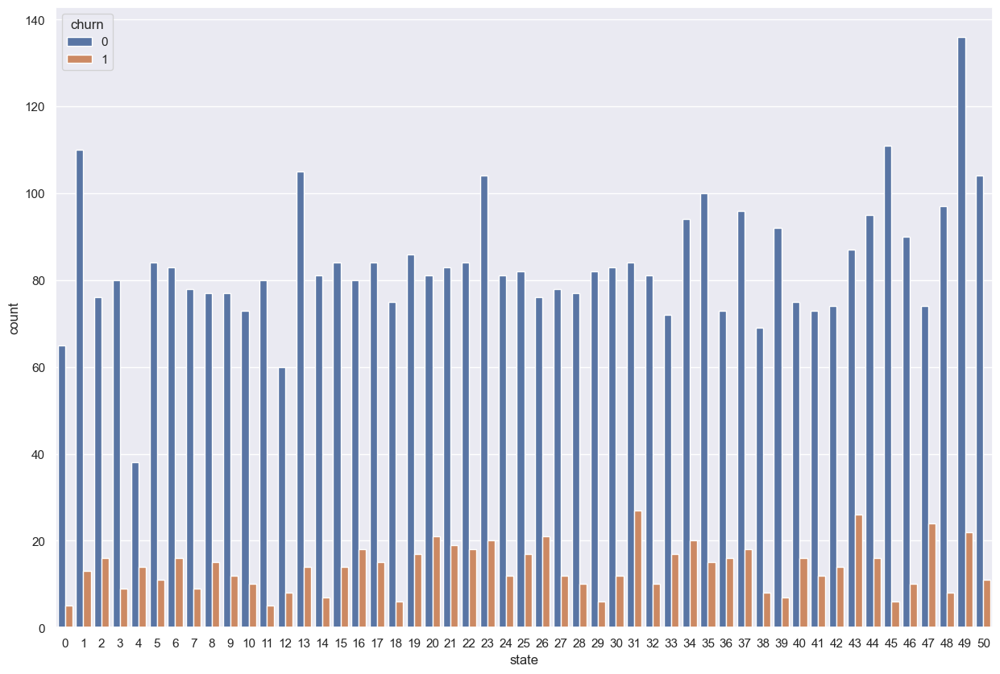

In [42]:
sns.set_style(style="darkgrid")
plt.figure(figsize=(15,10))

ax = sns.countplot(x = 'state', hue = 'churn', data = df)

In [43]:
# calculate a percentage of state and churn
sc = pd.crosstab(df["state"], df["churn"])

sc["percentage_churn"] = sc.apply(lambda x : (x[1] * 100)/(x[0]+x[1]),axis= 1)

print(sc)

churn    0   1  percentage_churn
state                           
0       65   5          7.142857
1      110  13         10.569106
2       76  16         17.391304
3       80   9         10.112360
4       38  14         26.923077
5       84  11         11.578947
6       83  16         16.161616
7       78   9         10.344828
8       77  15         16.304348
9       77  12         13.483146
10      73  10         12.048193
11      80   5          5.882353
12      60   8         11.764706
13     105  14         11.764706
14      81   7          7.954545
15      84  14         14.285714
16      80  18         18.367347
17      84  15         15.151515
18      75   6          7.407407
19      86  17         16.504854
20      81  21         20.588235
21      83  19         18.627451
22      84  18         17.647059
23     104  20         16.129032
24      81  12         12.903226
25      82  17         17.171717
26      76  21         21.649485
27      78  12         13.333333
28      77

<Axes: xlabel='area.code', ylabel='count'>

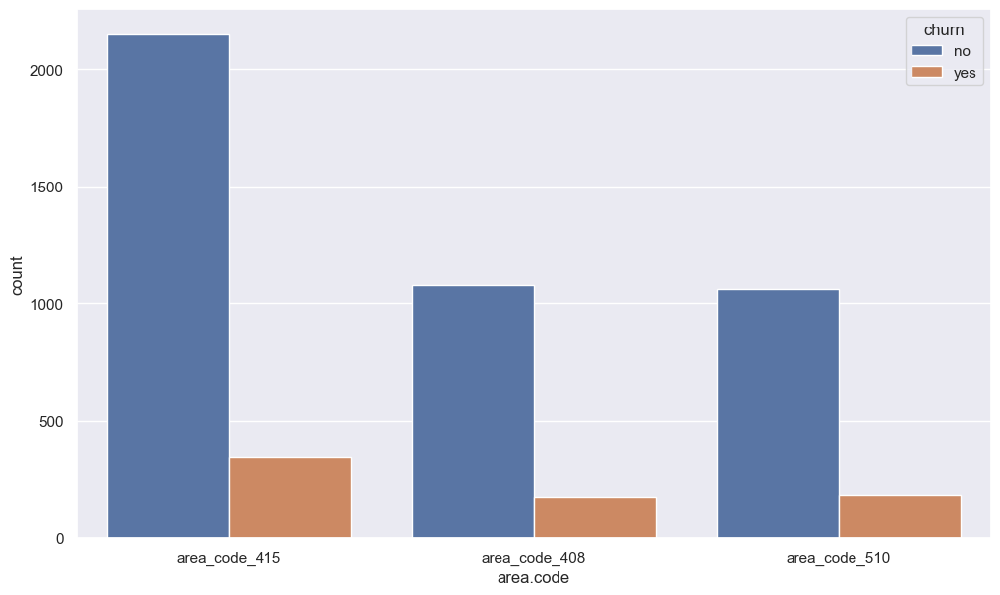

In [44]:
#churn numbers in each area
sns.set (rc = {'figure.figsize':(12,7)})

df1 = pd.read_excel('Churn.xlsx')

sns.countplot(x=df1['area.code'], hue=df1['churn'])

### Observation
Area code 415 has the highest Churn rate comapred to other areas.

### Analyzing all calls minutes,all calls, all calls charge together
***As these data sets are numerical data type, so for analysing with the 'churn' which is a catagorical data set, We are using mean, median, and box plots.***

In [45]:
#Print the mean value of churned and not churned customer 
print(df.groupby(['churn'])['day.calls'].mean())

churn
0    0.605408
1    0.610943
Name: day.calls, dtype: float64


In [46]:
#Print the mean value of churned and not churned customer
print(df.groupby(['churn'])['day.mins'].mean())

churn
0    0.499989
1    0.591426
Name: day.mins, dtype: float64


In [47]:
#Print the mean value of churned and not churned customer
print(df.groupby(['churn'])['day.charge'].mean())

churn
0    0.499957
1    0.591383
Name: day.charge, dtype: float64


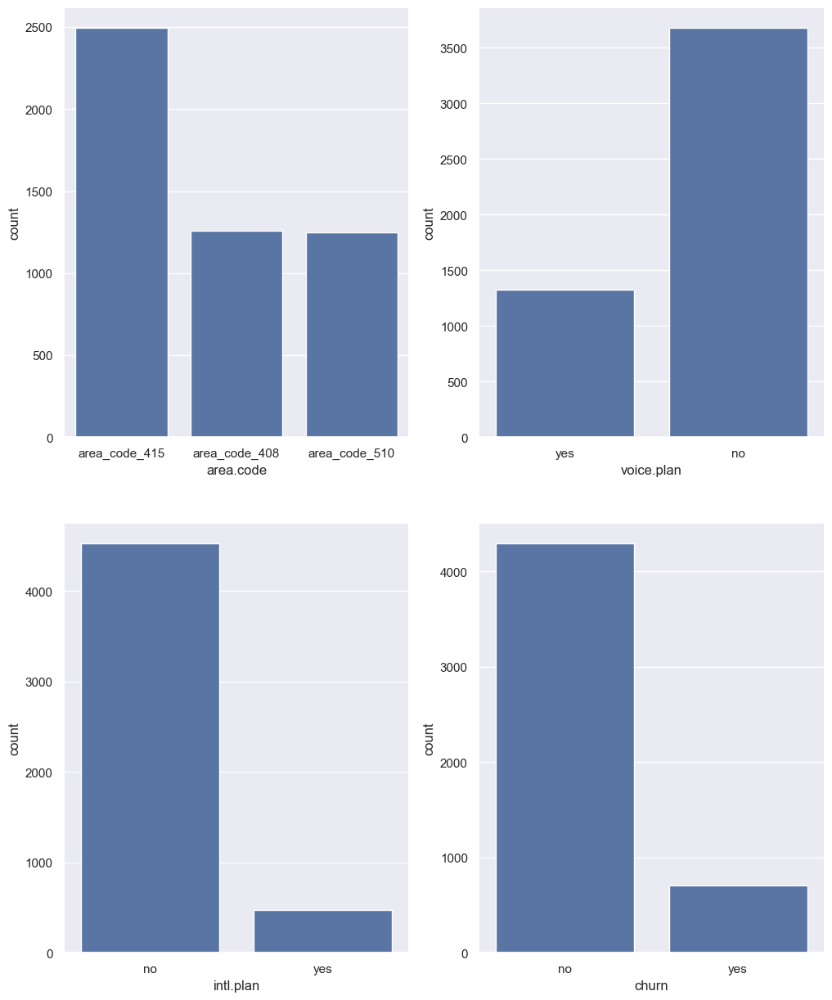

In [48]:
#visualizing the distribution of the categorical columns
figure, ax = plt.subplots(2,2,figsize = (12,15))

sns.countplot(x=df1["area.code"], ax=ax[0,0])

sns.countplot(x=df1["voice.plan"], ax=ax[0,1])

sns.countplot(x=df1["intl.plan"], ax=ax[1,0])

sns.countplot(x=df1["churn"], ax=ax[1,1])

plt.show()

**<span style="color:darkred">INFERENCES:**
    
*<span style="color:red">We can see how many customers we get from each area code.*
   
*<span style="color:red">We can see that a majority of people have not opted for the Voice Plan.* 
    
*<span style="color:red">We can see that a majority of people have not opted for the International Plan.*
    
*<span style="color:red">The churn rate is low so that means we are retaining more customers.*

<Axes: xlabel='customer.calls', ylabel='Density'>

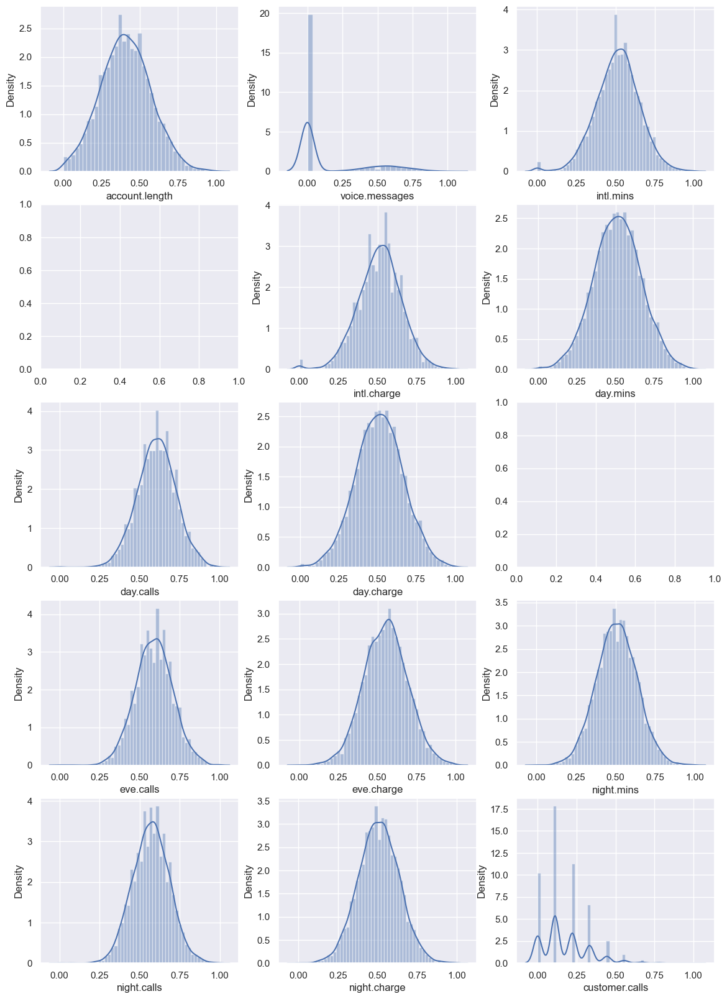

In [49]:
#histograms of the numerical features
figure, ax = plt.subplots(5,3,figsize = (14,20))

sns.distplot(df['account.length'], ax=ax[0,0])
sns.distplot(df['voice.messages'], ax=ax[0,1])
sns.distplot(df['intl.mins'], ax=ax[0,2])
sns.distplot(df['intl.charge'], ax=ax[1,1])
sns.distplot(df['day.mins'], ax=ax[1,2])
sns.distplot(df['day.calls'], ax=ax[2,0])
sns.distplot(df['day.charge'], ax=ax[2,1])
sns.distplot(df['eve.calls'], ax=ax[3,0])
sns.distplot(df['eve.charge'], ax=ax[3,1])
sns.distplot(df['night.mins'], ax=ax[3,2])
sns.distplot(df['night.calls'], ax=ax[4,0])
sns.distplot(df['night.charge'], ax=ax[4,1])
sns.distplot(df['customer.calls'], ax=ax[4,2])

Text(0.5, 1.0, 'Total Charge')

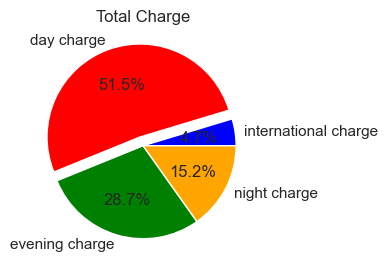

In [50]:
#total charge through a pie chart 
df1['day.charge'] = df1['day.charge'].astype(float)

sns.set (rc = {'figure.figsize':(3,4)})

charge = np.array([df1['intl.charge'].sum(), df1['day.charge'].sum(), df1['eve.charge'].sum(),
                  df1['night.charge'].sum()])

plt.pie(charge, labels=['international charge','day charge', 'evening charge','night charge'],
        autopct='%1.1f%%', explode = (0, 0.1, 0,0), colors=['blue','red','green','orange'])

plt.title('Total Charge')

Text(0.5, 1.0, 'Total Calls')

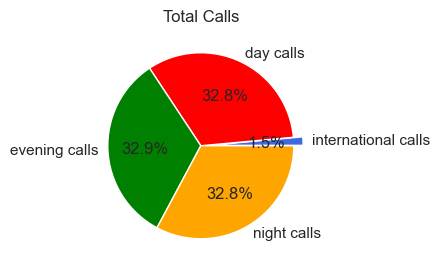

In [51]:
#total calls through a pie chart 
sns.set (rc = {'figure.figsize':(3,4)})

charge = np.array([df1['intl.calls'].sum(),df1['day.calls'].sum(),df1['eve.calls'].sum(),
                   df1['night.calls'].sum()])

plt.pie(charge, labels=['international calls','day calls', 'evening calls','night calls'],
        autopct='%1.1f%%', explode = (0.1, 0, 0,0), colors=['royalblue','red','green','orange'])

plt.title('Total Calls')

Text(0.5, 1.0, 'Total Minutes')

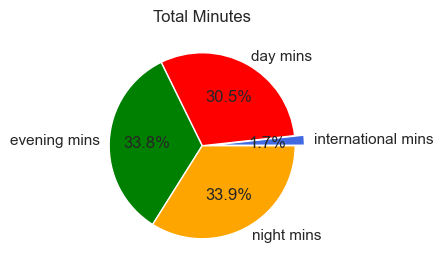

In [52]:
#total minutes through a pie chart 
df1['eve.mins'] = df1['eve.mins'].astype(float)

sns.set (rc = {'figure.figsize':(3,4)})

charge = np.array([df1['intl.mins'].sum(),df1['day.mins'].sum(),df1['eve.mins'].sum(),
                   df1['night.mins'].sum()])

plt.pie(charge, labels=['international mins','day mins', 'evening mins','night mins'],
        autopct='%1.1f%%', explode = (0.1, 0, 0,0), colors=['royalblue','red','green','orange'])

plt.title('Total Minutes')


In [53]:
# mean of the day.charge
fd = df['day.charge'].mean()
fd

0.5129284495599625

In [54]:
#customers whose charge was above average are valuable customers 
val = (df['day.charge'] > fd)

val_df = df.loc[val].head()

val_df

,state,area.code,account.length,voice.plan,voice.messages,intl.plan,intl.mins,intl.calls,intl.charge,day.mins,day.calls,day.charge,eve.mins,eve.calls,eve.charge,night.mins,night.calls,night.charge,customer.calls,churn
1,16,1,0.524793,1,0.480769,0,0.500,0.15,0.500000,0.754196,0.666667,0.754183,0.542755,0.582353,0.542866,0.619494,0.520000,0.619584,0.111111,0
3,31,1,0.561983,0,0.000000,0,0.610,0.25,0.609259,0.692461,0.690909,0.692436,0.333242,0.647059,0.333225,0.411646,0.594286,0.411930,0.000000,0
4,35,0,0.342975,0,0.000000,1,0.330,0.35,0.329630,0.851778,0.430303,0.851740,0.170195,0.517647,0.170171,0.498481,0.508571,0.498593,0.222222,0
6,1,2,0.483471,0,0.000000,1,0.315,0.30,0.314815,0.635562,0.593939,0.635542,0.606544,0.594118,0.606600,0.516203,0.674286,0.516601,0.000000,0
7,19,2,0.495868,1,0.461538,0,0.375,0.35,0.375926,0.620768,0.533333,0.620649,0.958207,0.635294,0.958266,0.538228,0.674286,0.538548,0.333333,0


In [55]:
#How many subscribtions are made to international plan by Area Code?
pd.crosstab(df['area.code'],df['intl.plan'],margins=True,margins_name='Total')

intl.plan,0,1,Total
area.code,,,
0,1140,109,1249
1,2255,224,2479
2,1104,137,1241
Total,4499,470,4969


In [56]:
#How many subscribtions are made to international plan by Area Code?
pd.crosstab(df['area.code'],df['voice.plan'],margins=True,margins_name='Total')

voice.plan,0,1,Total
area.code,,,
0,927,322,1249
1,1809,670,2479
2,918,323,1241
Total,3654,1315,4969


<Axes: xlabel='churn', ylabel='customer.calls'>

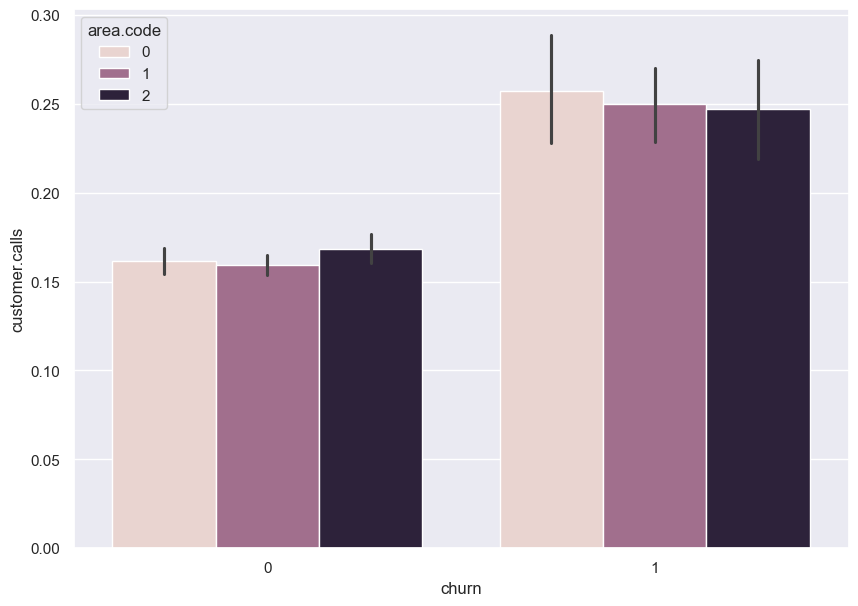

In [57]:
#customer calls vs churn in each area 
sns.set(rc = {'figure.figsize':(10,7)})
sns.barplot(x = df['churn'], y = df['customer.calls'], hue = df['area.code'])

*<span style="color:red">Customers who churned made more customer calls.*

# <span style="color:darkred">FEATURE SELECTION

In [58]:
#dividing into features and label
x = df.iloc[:,0:19]
x

,state,area.code,account.length,voice.plan,voice.messages,intl.plan,intl.mins,intl.calls,intl.charge,day.mins,day.calls,day.charge,eve.mins,eve.calls,eve.charge,night.mins,night.calls,night.charge,customer.calls
1,16,1,0.524793,1,0.480769,0,0.500,0.15,0.500000,0.754196,0.666667,0.754183,0.542755,0.582353,0.542866,0.619494,0.520000,0.619584,0.111111
2,35,1,0.438017,1,0.500000,0,0.685,0.15,0.685185,0.459744,0.745455,0.459672,0.537531,0.605882,0.537690,0.644051,0.588571,0.644344,0.111111
3,31,1,0.561983,0,0.000000,0,0.610,0.25,0.609259,0.692461,0.690909,0.692436,0.333242,0.647059,0.333225,0.411646,0.594286,0.411930,0.000000
4,35,0,0.342975,0,0.000000,1,0.330,0.35,0.329630,0.851778,0.430303,0.851740,0.170195,0.517647,0.170171,0.498481,0.508571,0.498593,0.222222
5,36,1,0.305785,0,0.000000,1,0.505,0.15,0.505556,0.474253,0.684848,0.474230,0.407754,0.717647,0.407959,0.473165,0.691429,0.473270,0.333333
6,1,2,0.483471,0,0.000000,1,0.315,0.30,0.314815,0.635562,0.593939,0.635542,0.606544,0.594118,0.606600,0.516203,0.674286,0.516601,0.000000
7,19,2,0.495868,1,0.461538,0,0.375,0.35,0.375926,0.620768,0.533333,0.620649,0.958207,0.635294,0.958266,0.538228,0.674286,0.538548,0.333333
8,24,1,0.603306,0,0.000000,1,0.355,0.30,0.355556,0.446657,0.478788,0.446620,0.283475,0.552941,0.283403,0.536203,0.548571,0.536297,0.000000
9,18,0,0.479339,0,0.000000,0,0.435,0.20,0.435185,0.524893,0.587879,0.524933,0.966731,0.470588,0.967001,0.546329,0.514286,0.546427,0.111111
10,49,1,0.578512,1,0.711538,1,0.560,0.25,0.559259,0.735704,0.509091,0.735609,0.610393,0.652941,0.610482,0.826329,0.554286,0.826674,0.000000


In [59]:
#dividing into features and label
y = df.iloc[0:,19]
y

1       0
2       0
3       0
4       0
5       0
6       0
7       0
8       0
9       0
10      0
11      1
12      0
14      0
15      0
16      1
17      0
18      0
19      0
20      0
21      0
22      1
23      0
24      0
25      0
26      0
27      0
29      0
30      0
31      0
32      0
33      0
34      1
35      0
36      0
37      0
38      0
39      0
40      0
41      0
42      1
43      0
44      0
45      0
46      0
47      0
49      1
50      0
51      0
52      0
53      0
54      0
55      1
56      0
57      0
58      1
59      0
60      0
61      0
62      0
63      0
64      0
65      0
66      0
67      0
68      0
69      0
70      1
71      0
72      0
73      0
74      0
75      0
76      0
77      1
78      1
79      0
80      0
81      0
82      0
83      0
84      0
85      1
86      0
87      1
88      0
89      0
91      0
92      1
93      0
94      0
95      0
96      0
97      0
98      0
99      1
100     1
101     0
102     0
104     0
105     0


**<span style="color:darkblue">SelectKBest using chi-squared test**

In [60]:
chi = SelectKBest(score_func=chi2, k=10)
chi.fit(x,y)

SelectKBest(score_func=<function chi2 at 0x0000027C8F7C9300>)

In [61]:
#selected 10 feature names
chi.get_feature_names_out()

array(['state', 'voice.plan', 'voice.messages', 'intl.plan', 'intl.calls',
       'day.mins', 'day.charge', 'eve.mins', 'eve.charge',
       'customer.calls'], dtype=object)

In [62]:
#dataframe with features and their feature importance

temp = pd.DataFrame()

temp["Feature"] = x.columns.tolist()

temp["Scores"] = chi.scores_.tolist()

temp.sort_values('Scores',ascending=False)

,Feature,Scores
5,intl.plan,305.958303
3,voice.plan,45.736898
18,customer.calls,27.344803
4,voice.messages,21.971400
9,day.mins,9.860320
11,day.charge,9.858783
0,state,1.950451
12,eve.mins,1.381384
14,eve.charge,1.381343
7,intl.calls,0.733300


**<span style="color:darkblue">SelectKBest using mutual information score**

In [63]:
info = SelectKBest(score_func=mutual_info_classif, k=10)
info.fit(x,y)

SelectKBest(score_func=<function mutual_info_classif at 0x0000027C8F7E0720>)

In [64]:
#selected 10 feature names
info.get_feature_names_out()

array(['state', 'area.code', 'voice.plan', 'voice.messages', 'intl.plan',
       'intl.mins', 'intl.calls', 'day.mins', 'day.charge',
       'customer.calls'], dtype=object)

In [65]:
#dataframe with features and their feature importance
temp1 = pd.DataFrame()
temp1["Feature"] = x.columns.tolist()
temp1["Scores"] = info.scores_.tolist()
temp1.sort_values('Scores',ascending=False)

,Feature,Scores
11,day.charge,0.056374
9,day.mins,0.055548
18,customer.calls,0.038557
5,intl.plan,0.026126
4,voice.messages,0.013081
0,state,0.012091
1,area.code,0.007759
6,intl.mins,0.003389
3,voice.plan,0.002662
7,intl.calls,0.001866


**<span style="color:darkblue">SelectKBest using ANOVA F-test**

In [66]:
f_c = SelectKBest(score_func=f_classif, k=10)
f_c.fit(x,y)

SelectKBest()

In [67]:
#selected 10 feature names
f_c.get_feature_names_out()

array(['voice.plan', 'voice.messages', 'intl.plan', 'intl.mins',
       'intl.charge', 'day.mins', 'day.charge', 'eve.mins', 'eve.charge',
       'customer.calls'], dtype=object)

In [68]:
#dataframe with features and their feature importance
temp2 = pd.DataFrame()
temp2["Feature"] = x.columns.tolist()
temp2["Scores"] = f_c.scores_.tolist()
temp2.sort_values('Scores',ascending=False)

,Feature,Scores
5,intl.plan,362.432573
18,customer.calls,237.061097
9,day.mins,224.522483
11,day.charge,224.511328
3,voice.plan,62.959702
4,voice.messages,48.751195
12,eve.mins,39.751024
14,eve.charge,39.744800
6,intl.mins,19.188216
8,intl.charge,19.183913


**<span style="color:darkblue">Recursive Feature Elimination**

In [69]:
lmodel = LogisticRegression(max_iter=400)
rfe = RFE(lmodel)
rfe.fit(x,y)

RFE(estimator=LogisticRegression(max_iter=400))

In [70]:
#number of features selected
rfe.n_features_

9

In [71]:
#selected feature names
rfe.get_feature_names_out()

array(['intl.plan', 'intl.calls', 'intl.charge', 'day.mins', 'day.charge',
       'eve.mins', 'eve.charge', 'night.mins', 'customer.calls'],
      dtype=object)

**<span style="color:darkblue">Feature Importance with Decision Trees Classifier**

In [72]:
tree = DecisionTreeClassifier()
tree.fit(x,y)

DecisionTreeClassifier()

In [73]:
#dataframe with features and their feature importance
temp3 = pd.DataFrame()
temp3["Feature"] = x.columns.tolist()
temp3["Scores"] = tree.feature_importances_.tolist()
temp3.sort_values('Scores',ascending=False)

,Feature,Scores
9,day.mins,0.206860
18,customer.calls,0.109736
8,intl.charge,0.091778
12,eve.mins,0.081010
7,intl.calls,0.077960
5,intl.plan,0.068708
3,voice.plan,0.060996
14,eve.charge,0.056898
11,day.charge,0.051647
15,night.mins,0.046162


In [74]:
#user-defined function to plot feature importances

names1 = x.columns.tolist()
def plot_feature_importance(importance,names,model_type):
    
    feature_importance = np.array(tree.feature_importances_)
    feature_names = np.array(names1)
    data={'feature_names':feature_names,'feature_importance':feature_importance}
    
    fi_df = pd.DataFrame(data)
    fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)

    plt.figure(figsize=(10,8))
    
    sns.barplot(x=fi_df['feature_importance'], y=fi_df['feature_names'])
    plt.title(model_type + '  FEATURE IMPORTANCE')
    plt.xlabel('FEATURE IMPORTANCE')
    plt.ylabel('FEATURE NAMES')

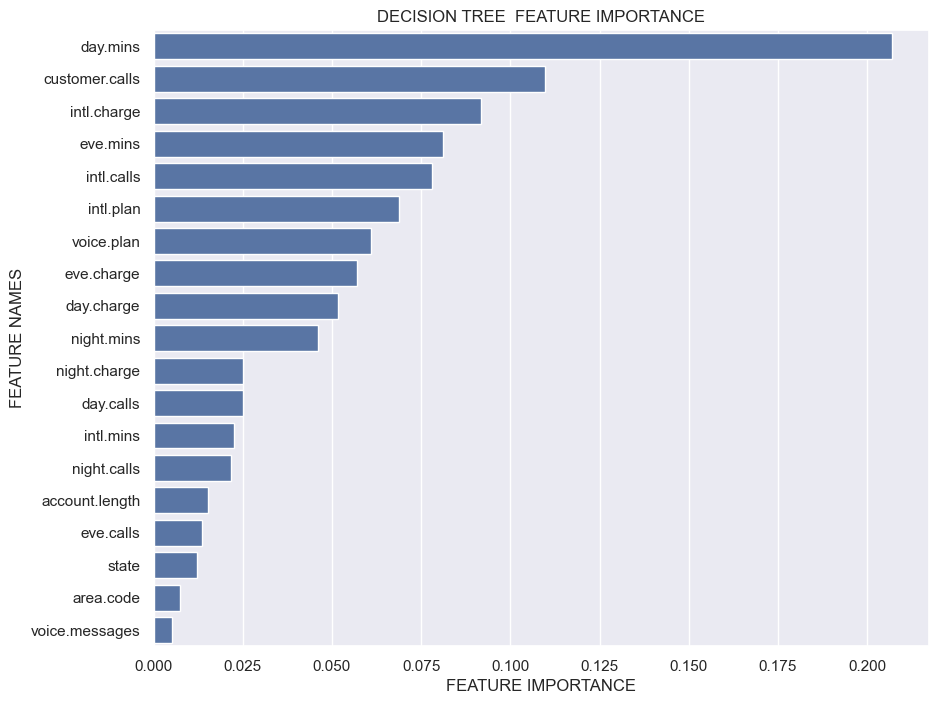

In [75]:
#plotting feature importance using Decision Tree
plot_feature_importance(tree.feature_importances_,names1,'DECISION TREE')

**<span style="color:darkblue">Forward Feature Selection**

In [76]:
ffs = SequentialFeatureSelector(lmodel, k_features=10, forward=True, n_jobs=-1)
ffs.fit(x,y)

SequentialFeatureSelector(estimator=LogisticRegression(max_iter=400),
                          k_features=(10, 10), n_jobs=-1, scoring='accuracy')

In [77]:
#selected 10 feature names
ffs.k_feature_names_

('state',
 'voice.plan',
 'voice.messages',
 'intl.plan',
 'intl.mins',
 'intl.calls',
 'intl.charge',
 'eve.calls',
 'night.calls',
 'customer.calls')

**<span style="color:darkblue">Backward Feature Selection**

In [78]:
bfs = SequentialFeatureSelector(lmodel, k_features=10, forward=False, n_jobs=-1)
bfs.fit(x,y)

SequentialFeatureSelector(estimator=LogisticRegression(max_iter=400),
                          forward=False, k_features=(10, 10), n_jobs=-1,
                          scoring='accuracy')

In [79]:
#selected 10 feature names
bfs.k_feature_names_

('account.length',
 'voice.plan',
 'intl.plan',
 'intl.mins',
 'intl.calls',
 'day.mins',
 'day.calls',
 'eve.mins',
 'night.mins',
 'customer.calls')

**<span style="color:darkblue">Exhaustive Feature Selection**

In [80]:
#Exhaustive Feature Selection
#efs = ExhaustiveFeatureSelector(LogisticRegression(), min_features=5, max_features=10, cv=1)
#efs.fit(x,y)

In [81]:
#efs.best

**<span style="color:darkblue">Selected columns after RFE feature selection**

In [82]:
selected_columns = df[rfe.get_feature_names_out()]
selected_columns

,intl.plan,intl.calls,intl.charge,day.mins,day.charge,eve.mins,eve.charge,night.mins,customer.calls
1,0,0.15,0.500000,0.754196,0.754183,0.542755,0.542866,0.619494,0.111111
2,0,0.15,0.685185,0.459744,0.459672,0.537531,0.537690,0.644051,0.111111
3,0,0.25,0.609259,0.692461,0.692436,0.333242,0.333225,0.411646,0.000000
4,1,0.35,0.329630,0.851778,0.851740,0.170195,0.170171,0.498481,0.222222
5,1,0.15,0.505556,0.474253,0.474230,0.407754,0.407959,0.473165,0.333333
6,1,0.30,0.314815,0.635562,0.635542,0.606544,0.606600,0.516203,0.000000
7,0,0.35,0.375926,0.620768,0.620649,0.958207,0.958266,0.538228,0.333333
8,1,0.30,0.355556,0.446657,0.446620,0.283475,0.283403,0.536203,0.000000
9,0,0.20,0.435185,0.524893,0.524933,0.966731,0.967001,0.546329,0.111111
10,1,0.25,0.559259,0.735704,0.735609,0.610393,0.610482,0.826329,0.000000


In [83]:
#selected features and label 
X = selected_columns
Y = y

# <span style="color:darkred">MODEL BUILDING

In [84]:
#balancing the imbalanced dataframe
ros = RandomOverSampler(random_state=42)
X_res, Y_res = ros.fit_resample(X,Y)

In [85]:
#train_test split
X_train, X_test, Y_train, Y_test = train_test_split(X_res, Y_res, test_size=0.32, random_state=42)

In [86]:
X_train

,intl.plan,intl.calls,intl.charge,day.mins,day.charge,eve.mins,eve.charge,night.mins,customer.calls
1801,0,0.10,0.494444,0.445235,0.445281,0.561727,0.561954,0.359241,0.222222
2095,0,0.15,0.820370,0.764723,0.764726,0.678031,0.678098,0.688354,0.000000
4404,0,0.25,0.485185,0.464296,0.464190,0.736596,0.736655,0.436962,0.111111
1357,0,0.10,0.509259,0.575818,0.575803,0.634314,0.634423,0.511392,0.333333
5836,1,0.10,0.525926,0.887624,0.887550,0.355788,0.355872,0.550886,0.000000
3217,0,0.35,0.359259,0.658037,0.657965,0.617817,0.617923,0.543291,0.111111
3208,0,0.10,0.244444,0.401138,0.401104,0.582898,0.582983,0.443544,0.333333
6993,0,0.25,0.390741,0.916927,0.916834,0.633489,0.633452,0.611392,0.222222
2943,0,0.60,0.320370,0.354196,0.354250,0.637064,0.637011,0.562532,0.111111
6255,1,0.30,0.779630,0.676529,0.676539,0.574374,0.574571,0.424810,0.222222


In [87]:
Y_train

1801    0
2095    0
4404    0
1357    0
5836    1
3217    0
3208    0
6993    1
2943    0
6255    1
4937    0
7507    1
4306    0
5184    1
3018    1
7678    1
2328    0
29      0
5160    1
7541    1
1092    0
124     0
4667    0
6454    1
8178    1
5400    1
2298    1
5623    1
1553    0
7450    1
598     0
4692    0
1416    0
4587    0
4557    0
5118    1
4262    0
2197    0
4391    0
4974    1
725     0
7265    1
4925    0
808     0
6045    1
958     1
4847    0
3934    1
810     0
834     0
3290    0
2423    0
4664    1
3282    0
1235    0
1225    0
5770    1
6264    1
4442    0
2970    0
6721    1
5403    1
3509    0
4482    0
8295    1
6069    1
1657    0
7511    1
7493    1
452     0
5812    1
5151    1
2818    0
2619    0
422     0
4387    0
1220    0
4229    0
4228    0
8211    1
4705    0
102     0
2418    0
5418    1
5517    1
8153    1
1580    0
5410    1
2206    0
170     0
6532    1
135     0
4581    0
8077    1
1310    0
7929    1
2284    0
4838    0
7378    1
4386    0


**<span style="color:darkblue">LOGISTIC REGRESSION**

In [88]:
#Logistic Regression using KFold validation technique

kfold = KFold(n_splits=3)

lr = LogisticRegression()

cross_v_l = cross_val_score(lr,X_res,Y_res,cv=kfold)

In [89]:
#cross validation scores and their mean
print(cross_v_l)
print('mean:',cross_v_l.mean()*100)

[0.59409075 0.75026381 0.35327234]
mean: 56.587563282253726


In [90]:
#Y_pred or Ŷ values
Y_pred = lr.fit(X_train,Y_train).predict(X_test)

In [91]:
#Accuracy score
acc = accuracy_score(Y_test,Y_pred)*100
print("Accuracy =", acc)

Accuracy = 76.7680469036277


In [92]:
#display confusion matrix
print(confusion_matrix(Y_test,Y_pred))

[[1037  333]
 [ 301 1058]]


In [93]:
#display classification report 
print(classification_report(Y_test,Y_pred))

              precision    recall  f1-score   support

           0       0.78      0.76      0.77      1370
           1       0.76      0.78      0.77      1359

    accuracy                           0.77      2729
   macro avg       0.77      0.77      0.77      2729
weighted avg       0.77      0.77      0.77      2729



In [94]:
#the probability estimates for each possible class label
lr.predict_proba(X_test)

array([[0.68076373, 0.31923627],
       [0.24039212, 0.75960788],
       [0.80959584, 0.19040416],
       ...,
       [0.81854463, 0.18145537],
       [0.37814716, 0.62185284],
       [0.79585443, 0.20414557]])

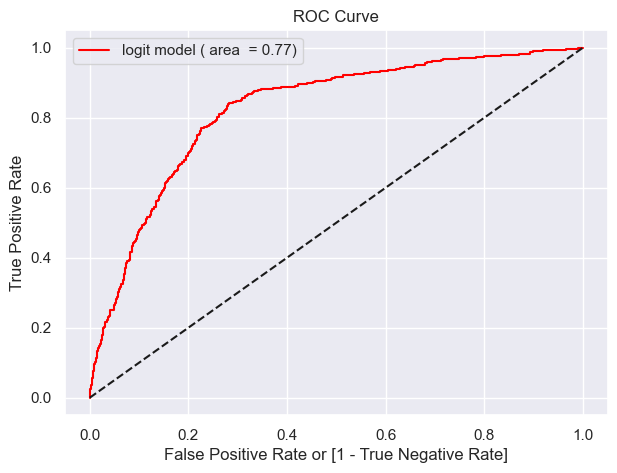

In [95]:
#plotting the ROC curve
fpr, tpr, thresholds = roc_curve(Y_test, lr.predict_proba (X_test)[:,1])
auc = roc_auc_score(Y_test, Y_pred)

sns.set (rc = {'figure.figsize':(7,5)})
plt.plot(fpr, tpr, color='red', label='logit model ( area  = %0.2f)'%auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.title('ROC Curve')
plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
plt.ylabel('True Positive Rate')
plt.legend()
plt.show()

**<span style="color:darkblue">K-NEAREST NEIGHBOR**

In [96]:
#KNN using KFold validation technique 
knn = KNeighborsClassifier(n_neighbors=2)
cross_val_knn = cross_val_score(knn,X_res,Y_res,cv=kfold)

In [97]:
#cross validation scores and their mean
print(cross_val_knn)
print('mean:',cross_val_knn.mean()*100)

[0.900809   0.94020401 0.8346235 ]
mean: 89.18788396652099


In [98]:
#Y_pred or Ŷ values
Y_pred1 = knn.fit(X_train,Y_train).predict(X_test)

In [99]:
#Accuracy score
acc = accuracy_score(Y_test,Y_pred1)*100

print("Accuracy =", acc)

Accuracy = 94.7233418834738


In [100]:
#display confusion matrix
print(confusion_matrix(Y_test,Y_pred1))

[[1270  100]
 [  44 1315]]


In [101]:
#display classification report 
print(classification_report(Y_test,Y_pred1))

              precision    recall  f1-score   support

           0       0.97      0.93      0.95      1370
           1       0.93      0.97      0.95      1359

    accuracy                           0.95      2729
   macro avg       0.95      0.95      0.95      2729
weighted avg       0.95      0.95      0.95      2729



In [102]:
#GridSeachCV for n_neighbors
estimator = KNeighborsClassifier()
param_grid = dict(n_neighbors = np.arange(2,42))
gridSearch = GridSearchCV(estimator,param_grid,)
gridSearch.fit(X_res,Y_res)

GridSearchCV(estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': array([ 2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18,
       19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35,
       36, 37, 38, 39, 40, 41])})

In [103]:
#printing the best parameters, best score of GridSearchCV
print(gridSearch.best_params_)
print(gridSearch.best_score_)

{'n_neighbors': 2}
0.9571998776098158


**<span style="color:darkblue">NAIVE BAYES**

In [104]:
#Bernoulli Naive Bayes using KFold validation technique 
bernoulli = BernoulliNB()
cross_val_bnb = cross_val_score(bernoulli,X_res,Y_res,cv=kfold)

In [105]:
#cross validation scores and their mean
print(cross_val_bnb)
print('mean:',cross_val_bnb.mean()*100)

[0.14773127 0.4474147  0.27867699]
mean: 29.127432020026227


In [106]:
#Y_pred or Ŷ values
Y_pred2 = bernoulli.fit(X_train,Y_train).predict(X_test)

In [107]:
#Accuracy score
acc = accuracy_score(Y_test,Y_pred2)*100
print("Accuracy =", acc)

Accuracy = 61.52436790032979


In [108]:
#display confusion matrix
print(confusion_matrix(Y_test,Y_pred2))

[[1272   98]
 [ 952  407]]


In [109]:
#display classification report 
print(classification_report(Y_test,Y_pred2))

              precision    recall  f1-score   support

           0       0.57      0.93      0.71      1370
           1       0.81      0.30      0.44      1359

    accuracy                           0.62      2729
   macro avg       0.69      0.61      0.57      2729
weighted avg       0.69      0.62      0.57      2729



**<span style="color:darkblue">SUPPORT VECTOR MACHINE**

In [110]:
#SVM using KFold validation technique
svm = SVC(C=10, gamma=100)
cross_val_svm = cross_val_score(svm,X_res,Y_res,cv=kfold)

In [111]:
#cross validation scores and their mean
print(cross_val_svm)
print('mean:',cross_val_svm.mean()*100)

[0.9683433  0.97889553 0.99859254]
mean: 98.19437908946495


In [112]:
#Y_pred or Ŷ values
Y_pred3 = svm.fit(X_train,Y_train).predict(X_test)

In [113]:
#Accuracy score
acc = accuracy_score(Y_test,Y_pred3)*100
print("Accuracy =", acc)

Accuracy = 98.3876877977281


In [114]:
#display confusion matrix
print(confusion_matrix(Y_test,Y_pred3))

[[1336   34]
 [  10 1349]]


In [115]:
#display classification report 
print(classification_report(Y_test,Y_pred3))

              precision    recall  f1-score   support

           0       0.99      0.98      0.98      1370
           1       0.98      0.99      0.98      1359

    accuracy                           0.98      2729
   macro avg       0.98      0.98      0.98      2729
weighted avg       0.98      0.98      0.98      2729



In [116]:
#hyper-parameter tuning for SVM
est = SVC()
param = [{'kernel':['linear','rbf'],'C':[0.0001, 1, 10],'gamma':[1, 10, 100]}]
gridsearch = GridSearchCV(est,param,cv=2)
gridsearch.fit(X_res,Y_res)

GridSearchCV(cv=2, estimator=SVC(),
             param_grid=[{'C': [0.0001, 1, 10], 'gamma': [1, 10, 100],
                          'kernel': ['linear', 'rbf']}])

In [117]:
#printing the best parameters, best score of GridSearchCV
print(gridsearch.best_params_)
print(gridsearch.best_score_)

{'C': 10, 'gamma': 100, 'kernel': 'rbf'}
0.9752579737335835


In [118]:
#printing the best estimator of GridSearchCV
gridsearch.best_estimator_

SVC(C=10, gamma=100)

**<span style="color:darkblue">RANDOM FOREST**

In [119]:
#Random Forest using KFold validation technique
rf = RandomForestClassifier(bootstrap=False, max_depth=100, max_features='auto',
                            min_samples_leaf=2, n_estimators=500)
cross_val_rf = cross_val_score(rf,X_res,Y_res,cv=kfold)

In [120]:
#cross validation scores and their mean
print(cross_val_rf)
print('mean:',cross_val_rf.mean()*100)

[0.95321843 0.98311643 0.98979592]
mean: 97.53769253040647


In [121]:
#Y_pred or Ŷ values
Y_pred4 = rf.fit(X_train,Y_train).predict(X_test)

In [122]:
#Accuracy score
acc = accuracy_score(Y_test,Y_pred4)*100
print("Accuracy =", acc)

Accuracy = 97.98460974716014


In [123]:
#display confusion matrix
print(confusion_matrix(Y_test,Y_pred4))

[[1327   43]
 [  12 1347]]


In [124]:
#display classification report 
print(classification_report(Y_test,Y_pred4))

              precision    recall  f1-score   support

           0       0.99      0.97      0.98      1370
           1       0.97      0.99      0.98      1359

    accuracy                           0.98      2729
   macro avg       0.98      0.98      0.98      2729
weighted avg       0.98      0.98      0.98      2729



In [125]:
#hyper-parameter tuning for Random Forest 
estimator_rf = RandomForestClassifier()
param_rf = [{'max_depth': [2,3,5,None],'min_samples_leaf': [2,4,5],
             'n_estimators': [100,300,500],'max_features':['auto','sqrt'],
             'max_depth':[10,50,100],'min_samples_split':[2,5,10],
             'bootstrap':[True, False]}]
rf_random = RandomizedSearchCV(estimator = estimator_rf, param_distributions = param_rf, 
                               n_iter = 100, cv = 2, verbose=2, random_state=42, n_jobs = -1)
rf_random.fit(X_res,Y_res)

Fitting 2 folds for each of 100 candidates, totalling 200 fits


RandomizedSearchCV(cv=2, estimator=RandomForestClassifier(), n_iter=100,
                   n_jobs=-1,
                   param_distributions=[{'bootstrap': [True, False],
                                         'max_depth': [10, 50, 100],
                                         'max_features': ['auto', 'sqrt'],
                                         'min_samples_leaf': [2, 4, 5],
                                         'min_samples_split': [2, 5, 10],
                                         'n_estimators': [100, 300, 500]}],
                   random_state=42, verbose=2)

**<span style="color:darkblue">Choosing final model**

In [126]:
#printing the best parameters, best score of GridSearchCV
print(rf_random.best_params_)
print(rf_random.best_score_)

{'n_estimators': 500, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'max_depth': 50, 'bootstrap': False}
0.9766651031894934


In [127]:
#printing the best estimator of GridSearchCV
rf_random.best_estimator_

RandomForestClassifier(bootstrap=False, max_depth=50, min_samples_leaf=2,
                       n_estimators=500)

In [128]:
#comparing the mean of cross-validation scores of all the models
mean_df = pd.DataFrame({'Model':['Logistic Regression','KNN','SVM','Naive Bayes','Random Forest'],
                       'Score':[cross_v_l.mean()*100,cross_val_knn.mean()*100,cross_val_svm.mean()*100,
                                   cross_val_bnb.mean()*100,cross_val_rf.mean()*100]})
mean_df.sort_values(by='Score',ascending=False)

,Model,Score
2,SVM,98.194379
4,Random Forest,97.537693
1,KNN,89.187884
0,Logistic Regression,56.587563
3,Naive Bayes,29.127432


In [129]:
model = rf.fit(X_res,Y_res)

# <span style="color:darkred">STREAMLIT DEPLOYMENT


In [130]:
import pickle
pickle.dump(model, open(" r_d.pkl ", 'wb'))